# "Selective ControlNet" mini project

I've spent around 3 days on this task, and you're welcome to check out my results!

See the table of contents in the sidebar.

In [ ]:
!pip install controlnet_aux
!pip install diffusers transformers accelerate

In [1]:
from diffusers import StableDiffusionControlNetInpaintPipeline, ControlNetModel
from diffusers import DDIMScheduler, UniPCMultistepScheduler, DPMSolverMultistepScheduler
from diffusers.utils import load_image, make_image_grid
import numpy as np
import torch
import cv2
from PIL import Image, ImageOps
from controlnet_aux import LineartDetector
import transformers
import torchvision
from torchvision import transforms

/beegfs/home/egor.burkov/face-replacement-2025-04/.env/lib/python3.9/site-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


## Task

**Input**: image $I$ + foreground prompt $P_f$ + background prompt $P_b$

**Output**: $I$ stylized according to $P_f$ (preserving the spatial structure) and the background in this image generated according to $P_b$ (any spatial structure, but semantically consistent around the object).

We are suggested to use ControlNet for spatial conditioning.

## Models

**Base model**. I've picked SD 1.5 because
* it's very efficient compared to SDXL/FLUX.1 and I didn't want to spend time on VRAM optimization,
* it's so popular that there is even a joint ControlNet+inpainting implementation in the `diffusers` library,
* even though the stock SD 1.5 is rather bad, there are hundreds of good checkpoints for various purposes; I've chosen a general-purpose checkpoint called Protogen.

**ControlNet**. For now I'll stick to the suggested "lineart" ControlNet, though other types are perfectly suitable. For automatic creation of control images, there is an image-to-lineart tool provided by Huggingface's `controlnet_aux` library.

**Implementation**. `lllyasviel`'s GitHub seems to be abandoned, but they have converted their ControlNets to be used with diffusers library. This is my favorite library, and, importantly for this task, we can use diffusers' `StableDiffusionControlNetInpaintPipeline` with those models. (details on this interface below)

In [2]:
controlnet = ControlNetModel.from_pretrained(
    "lllyasviel/control_v11p_sd15_lineart", torch_dtype=torch.float16
)
diffusion_pipeline = StableDiffusionControlNetInpaintPipeline.from_pretrained(
    "darkstorm2150/Protogen_x3.4_Official_Release",
    controlnet=controlnet,
    torch_dtype=torch.float16,
    use_safetensors=False,
    safety_checker=None,
)
diffusion_pipeline = diffusion_pipeline.to("cuda")

diffusion_pipeline.scheduler = DPMSolverMultistepScheduler.from_config(
    diffusion_pipeline.scheduler.config, use_karras_sigmas=True
)
# diffusion_pipeline.enable_model_cpu_offload()

# 512 is the recommended size for stock SD1.5, seems to be good for Protogen too
sd15_image_transform = transforms.Compose([
    transforms.v2.Resize(size=None, max_size=512),
])

# Neural net that converts images to line-art
lineart_detector = LineartDetector.from_pretrained("lllyasviel/Annotators")
# lineart_detector = lineart_detector.to("cuda")

def get_control_image(image: Image):
    control_image = lineart_detector(image)
    # this is the inverse of LineartDetector's preprocessing
    # which resizes to the closest multiple of 64, see controlnet_aux/util.py
    return control_image.resize(image.size)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet_inpaint.StableDiffusionControlNetInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [3]:
def resize_to_screen(image: Image):
    if image.width > 1500:
        factor = 1500 / image.width
        new_width = round(image.width * factor)
        new_height = round(image.height * factor)
        image = image.resize((new_width, new_height))
    return image

def display_row(images):
    return resize_to_screen(
        make_image_grid(images, rows=1, cols=len(images))
    )

StableDiffusionControlNetInpaintPipeline was intended as an interface to use diffusion-based inpainting **and** ControlNet at the same time. However, by passing proper parameters, it is possible to use none, one, or both!

In our case, inpainting will be useful later for re-rendering the background. I will explain it later; for now let's just use it for plain ControlNet generation (control+text -> image). This can be achieved by providing full white inpainting mask (i.e. inpaint everything and disregard the initial image).

By the way, we can tune the degree to which the network follows the control by weighting the ControlNet outputs' addition, 0.0 (= control doesn't affect generation) to 1.0:

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

mermaid underwater, blue clothes, corals and fishes background


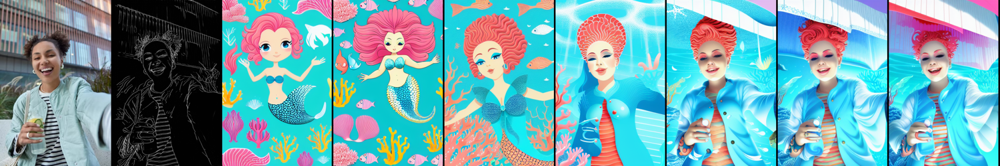

In [260]:
def text_to_image(prompt, control_image, **extra_diffusion_kwargs):
    """
    Generate an image based on a text prompt and a control image.
    """
    diffusion_kwargs = dict(
        prompt=prompt,
        negative_prompt="worst quality, low quality, blurry, ugly",
        image=init_image,
        mask_image=Image.new('L', init_image.size, color='white'), # full white = inpainting switched off
        control_image=control_image,
        controlnet_conditioning_scale=0.85,  # 0.0 = lineart control switched off
        num_inference_steps=30,
        generator=torch.Generator(device=diffusion_pipeline.device).manual_seed(123),
    )
    diffusion_kwargs.update(extra_diffusion_kwargs)
    return diffusion_pipeline(**diffusion_kwargs).images[0]

init_image = sd15_image_transform(load_image("./dataset/a.jpg"))
control_image = get_control_image(init_image)
prompt = "mermaid underwater, blue clothes, corals and fishes background"

controlnet_scales = [0.0, 0.15, 0.3, 0.5, 0.7, 0.85, 1.0]
generated_images = [
    text_to_image(prompt, control_image, controlnet_conditioning_scale=c) for c in controlnet_scales
]
print(prompt)
display_row([init_image, control_image] + generated_images)

## Method 1. Specify the background in prompt (a silly but very quick solution)

mermaid underwater, blue clothes, corals and fish in the background, vivid background with sea creatures, marine life


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

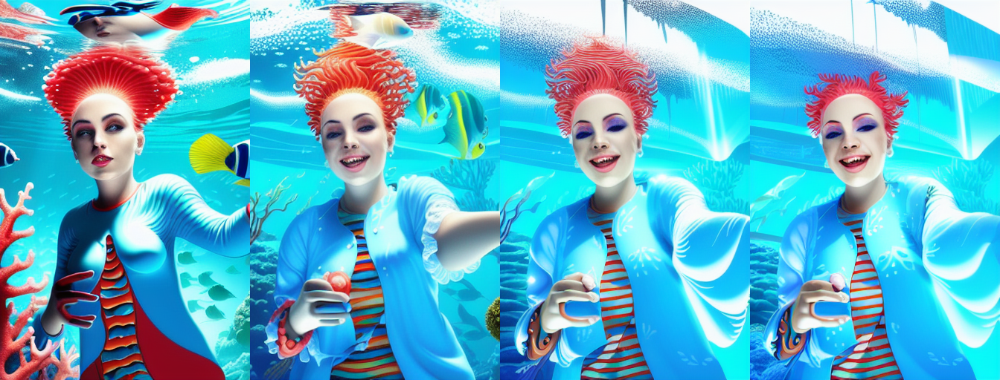

In [261]:
init_image = sd15_image_transform(load_image("./dataset/a.jpg"))
control_image = get_control_image(init_image)
prompt = "mermaid underwater, blue clothes, corals and fish in the background, vivid background with sea creatures, marine life"

print(prompt)
display_row([
    text_to_image(prompt, control_image, controlnet_conditioning_scale=0.5),
    text_to_image(prompt, control_image, controlnet_conditioning_scale=0.75),
    text_to_image(prompt, control_image, controlnet_conditioning_scale=0.9),
    text_to_image(prompt, control_image, controlnet_conditioning_scale=1.0),
])

The main problem here is the original background affecting the generation through the control image.

We can use a good foreground segmentation algorithm like RMBG 1.4/2 to get a background mask and build something around it:

In [262]:
foreground_segm_model = transformers.pipeline(
    "image-segmentation",
    model="briaai/RMBG-1.4",
    trust_remote_code=True
)

Device set to use cuda:0


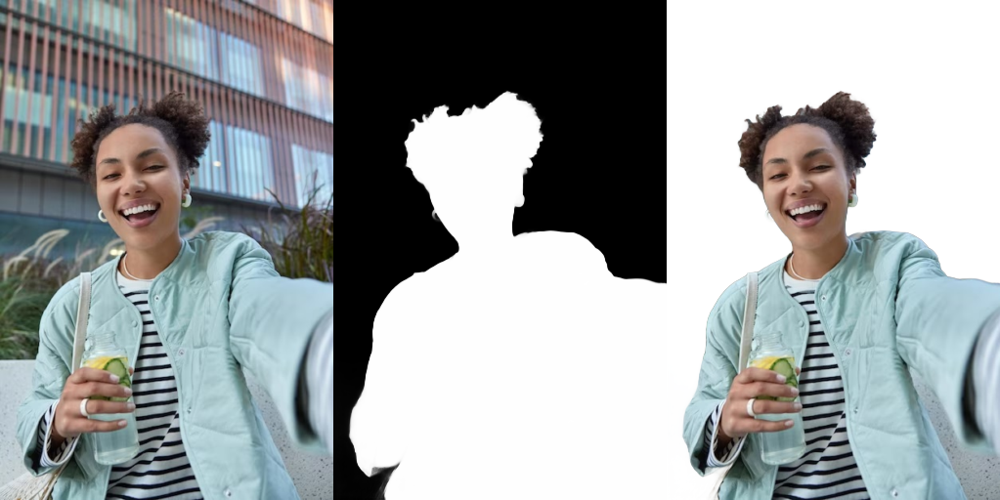

In [263]:
init_image = load_image("./dataset/a.jpg")
init_image = sd15_image_transform(init_image)
foreground_mask = foreground_segm_model(init_image, return_mask=True)

display_row([
    init_image,
    foreground_mask,
    Image.composite(init_image, Image.new('RGB', init_image.size, 'white'), foreground_mask)
])

## Method 2. Erase background from the control image (a slightly less naive solution)

This works noticeably better:

mermaid underwater, blue clothes, corals and fish in the background, vivid background with sea creatures, marine life


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

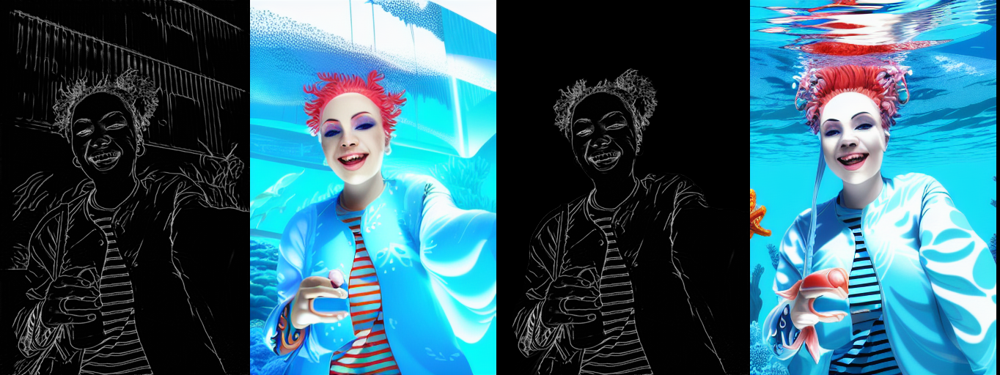

In [264]:
prompt = "mermaid underwater, blue clothes, corals and fish in the background, vivid background with sea creatures, marine life"
init_image = sd15_image_transform(load_image("./dataset/a.jpg"))
foreground_mask = foreground_segm_model(init_image, return_mask=True)
control_image = get_control_image(init_image)

# "Remove background" from the control image
control_image_clean = Image.composite(
    control_image,
    Image.new('L', control_image.size, color='black'),
    foreground_mask
)

print(prompt)
display_row([
    control_image,
    text_to_image(prompt, control_image, controlnet_conditioning_scale=1.0),
    control_image_clean,
    text_to_image(prompt, control_image_clean, controlnet_conditioning_scale=1.0),
])

a diabolical race car, many tall skyscrapers in the background, cyberpunk


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

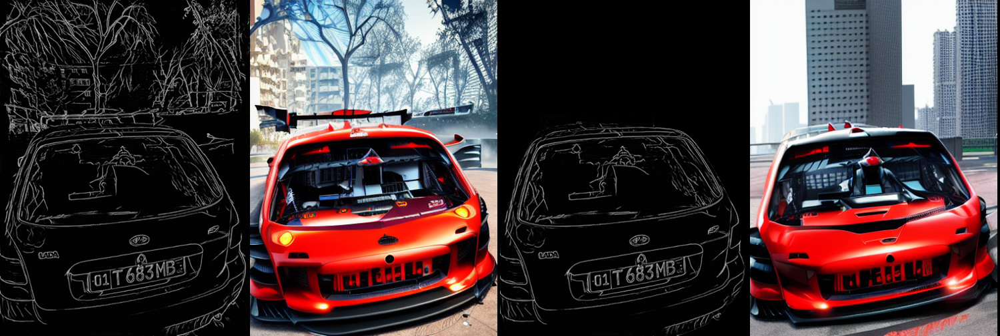

In [265]:
prompt = "a diabolical race car, many tall skyscrapers in the background, cyberpunk"
init_image = sd15_image_transform(load_image("./dataset/h.jpg"))
foreground_mask = foreground_segm_model(init_image, return_mask=True)
control_image = get_control_image(init_image)

# "Remove background" from the control image
control_image_clean = Image.composite(
    control_image,
    Image.new('L', control_image.size, color='black'),
    foreground_mask
)

print(prompt)
display_row([
    control_image,
    text_to_image(prompt, control_image, controlnet_conditioning_scale=1.0),
    control_image_clean,
    text_to_image(prompt, control_image_clean, controlnet_conditioning_scale=1.0),
])

many people at a served table, royal dinner, lots of cutlery next to plates, high-quality DSLR photo


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

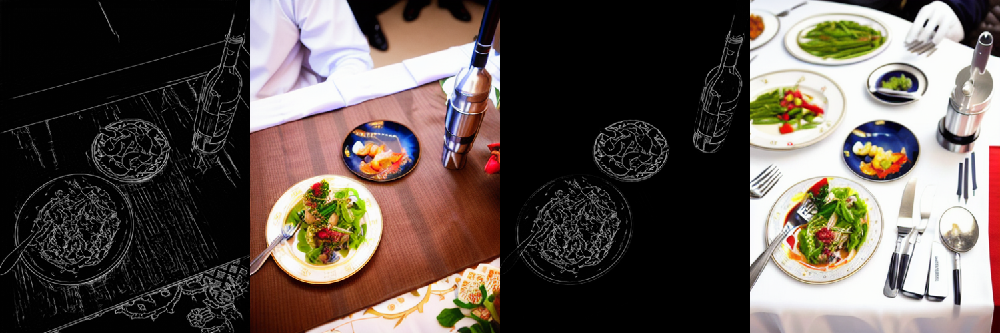

In [266]:
prompt = "many people at a served table, royal dinner, lots of cutlery next to plates, high-quality DSLR photo"
init_image = sd15_image_transform(load_image("./dataset/i.jpg"))
foreground_mask = foreground_segm_model(init_image, return_mask=True)
control_image = get_control_image(init_image)

# "Remove background" from the control image
control_image_clean = Image.composite(
    control_image,
    Image.new('L', control_image.size, color='black'),
    foreground_mask
)

print(prompt)
display_row([
    control_image,
    text_to_image(prompt, control_image, controlnet_conditioning_scale=0.75),
    control_image_clean,
    text_to_image(prompt, control_image_clean, controlnet_conditioning_scale=0.75),
])

This approach has downsides:
* control may still influence background, making it dull and less detailed,
* it's hard to use a different prompt for it.

So here's one better approach:

## Diffusion inpainting for background

Inpainting with diffusion is quite common and comes in various flavors.

In the most basic approach, the image to inpaint is noised to some extent (say 90%) in the latent space, then denoised back (which re-generates the entire image but preserving the general structure), and its part corresponding to the area to inpaint is pasted back into the original image.

On another extreme are conditioned diffusion models like ControlNets fine-tined specifically to the inpainting task.

I've read the code of `StableDiffusionControlNetInpaintPipeline` to study their own training-free algorithm, here's the gist:

1. The image is optionally cropped to the inpainting mask plus some margin (controlled with `padding_mask_crop` parameter; `None` = "don't apply this step") and resized to be convenient for the model (e.g. 512 x 512) in case the inpainting area is very small. Since we are dealing with background, `padding_mask_crop=0` will often not crop anything. However, even in that case there is a subtle implementation difference: `padding_mask_crop=None` will re-generate the entire image (so the object may become slightly altered), while padding_mask_crop=0 will keep the object from the initial image as is and will only paste the inpainted parts. The former might be userful sometimes but I haven't seen much benefit from it, in my experience the latter works just right, and the distortion of the object could be significant with SD1.5.

1. The image to inpaint is mapped into the latent space and noise is added to some extent (`strength` parameter). 100% will ignore the existing content in the inpainting area, while <100% will try to follow the existing structure. When I used diffusers' inpainting for replacing faces I found 50% to be enough for changing facial identity. In this case however we need 100% since we are asked to re-generate background from scratch.

1. The inpainting mask is resized to the latent space spatial size (!). With our models, this means 8 times smaller (`diffusion_pipeline.vae_scale_factor`).

1. The original image is brought into the latent space. At each denoising step, it's added with noise according to our current noise level, and the parts that don't need to be inpainted (in our case, the object/person) from it are pasted into the current latent variable with the help of the "latent space mask" from the previous step.

Here is what it looks like, without ControlNet for now:

  0%|          | 0/30 [00:00<?, ?it/s]

a woman with corals and fish in the background


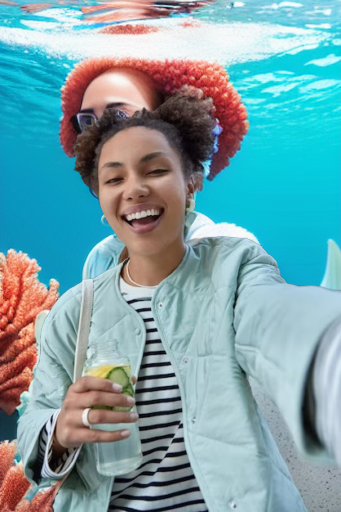

In [267]:
def inpaint_background(prompt, init_image, **extra_diffusion_kwargs):
    """
    Detect background in `init_image` and re-render it based on `prompt`.
    """
    foreground_mask = foreground_segm_model(init_image, return_mask=True)
    background_mask = ImageOps.invert(foreground_mask)

    if extra_diffusion_kwargs.get('controlnet_conditioning_scale', 0) != 0:
        control_image = get_control_image(init_image)
        # "Remove background" from the control image
        control_image = Image.composite(
            control_image,
            Image.new('L', control_image.size, color='black'),
            foreground_mask
        )
    else:
        control_image = init_image # doesn't matter anyway when scale is 0.0
    
    diffusion_kwargs = dict(
        prompt=prompt,
        negative_prompt="worst quality, low quality, blurry, ugly",
        image=init_image,
        mask_image=background_mask,
        control_image=control_image,
        controlnet_conditioning_scale=0.0,  # 0.0 = lineart control switched off
        num_inference_steps=30,
        padding_mask_crop=0,
        strength=1.0,
        generator=torch.Generator(device=diffusion_pipeline.device).manual_seed(123),
    )
    diffusion_kwargs.update(extra_diffusion_kwargs)
    return diffusion_pipeline(**diffusion_kwargs).images[0]

prompt = "a woman with corals and fish in the background"
init_image = sd15_image_transform(load_image("./dataset/a.jpg"))

generated_image = inpaint_background(prompt, init_image)
print(prompt)
display_row([generated_image])

Yes, inpainting is notorious for unwanted content. People usually fight this with prompt engineering and playing with control images:

underwater, corals and fish in the background


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

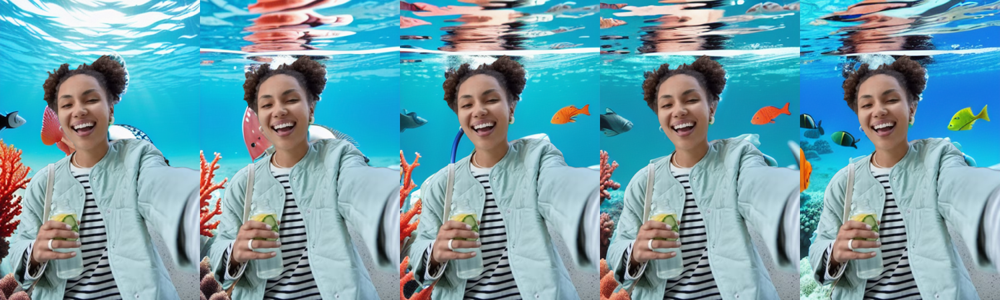

In [268]:
init_image = sd15_image_transform(load_image("./dataset/a.jpg"))

prompt = "underwater, corals and fish in the background"
print(prompt)
display_row([
    inpaint_background(prompt, init_image),
    inpaint_background(prompt, init_image, controlnet_conditioning_scale=0.25),
    inpaint_background(prompt, init_image, controlnet_conditioning_scale=0.5),
    inpaint_background(prompt, init_image, controlnet_conditioning_scale=0.75),
    inpaint_background(prompt, init_image, controlnet_conditioning_scale=1.0),
])

## Method 3. Use diffusion inpainting for background in a generated image

If we combine the above methods, we can more or less solve the ultimate task.

**Legend for the grids below:**:

1. original image;
1. easy method with erasing the background in the control image;
1. foreground mask;
1. full method with re-generation of the background image, possibly with a different prompt.

In [269]:
def stylize(
    init_image,
    prompt,
    background_prompt=None,
    extra_fg_diffusion_kwargs=dict(),
    extra_bg_diffusion_kwargs=dict(),
    detect_background_in_generated_image=False,
    return_intermediates=False,
):
    """
    Stylize the foreground object in `init_image` based on `prompt` and draw
    a new background based on `background_prompt` (defaults to `prompt`).

    The background is determined from `init_image` by default, or from
    the stylized image if `detect_background_in_generated_image == True`.
    """
    if background_prompt is None:
        background_prompt = prompt

    # Get a background mask
    foreground_mask = foreground_segm_model(init_image, return_mask=True)
    background_mask = ImageOps.invert(foreground_mask)

    # Convert init_image into control image ("lineart")
    control_image = get_control_image(init_image)
    # "Remove background" from the control image
    control_image = Image.composite(
        control_image,
        Image.new('L', control_image.size, color='black'),
        foreground_mask
    )

    # Step 1. Stylize the object in init_image
    diffusion_kwargs = dict(
        prompt=prompt,
        negative_prompt=["worst quality, low quality, blurry"][0],
        image=init_image,
        mask_image=Image.new('L', init_image.size, color='white'), # "inpaint everything"
        strength=1.0, # 1.0 = full noise, don't rely on existing content
        control_image=control_image,
        controlnet_conditioning_scale=0.85,
        guidance_scale=7.5,
        eta=0.0,
        num_inference_steps=30,
        padding_mask_crop=None,
        generator=torch.Generator(device="cuda").manual_seed(123),
    )
    diffusion_kwargs.update(extra_fg_diffusion_kwargs)
    foreground_stylized = diffusion_pipeline(**diffusion_kwargs).images[0]

    # This image will have a slightly different size due to VaeImageProcessor.process' behavior.
    # Resize back (restoring aspect ratio) because it's using resize_mode="default" here:
    # https://github.com/huggingface/diffusers/blob/5873377a660dac60a6bd86ef9b4fdfc385305977/src/diffusers/pipelines/controlnet/pipeline_controlnet_inpaint.py#L1313
    foreground_stylized = foreground_stylized.resize(init_image.size)

    # The object may have changed appearance so the user may
    # want to recompute the background mask
    if detect_background_in_generated_image:
        foreground_mask = foreground_segm_model(foreground_stylized, return_mask=True)
        background_mask = ImageOps.invert(foreground_mask)

    # Step 2. Re-render (inpaint) the background
    diffusion_kwargs = dict(
        prompt=background_prompt,
        negative_prompt=["worst quality, low quality, blurry"][0],
        image=foreground_stylized,
        mask_image=background_mask,
        strength=1.0,
        control_image=control_image,
        controlnet_conditioning_scale=0.5,
        guidance_scale=7.5,
        eta=0.0,
        num_inference_steps=30,
        padding_mask_crop=0,
        generator=torch.Generator(device="cuda").manual_seed(123),
    )
    diffusion_kwargs.update(extra_bg_diffusion_kwargs)
    entire_image_stylized = diffusion_pipeline(**diffusion_kwargs).images[0]
    
    if return_intermediates:
        return foreground_stylized, foreground_mask, entire_image_stylized
    else:
        return entire_image_stylized

Step 1 prompt: mermaid underwater, blue clothes, corals and fishes background, realistic, high quality photo
Step 2 prompt: mermaid underwater, blue clothes, corals and fishes background, realistic, high quality photo


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

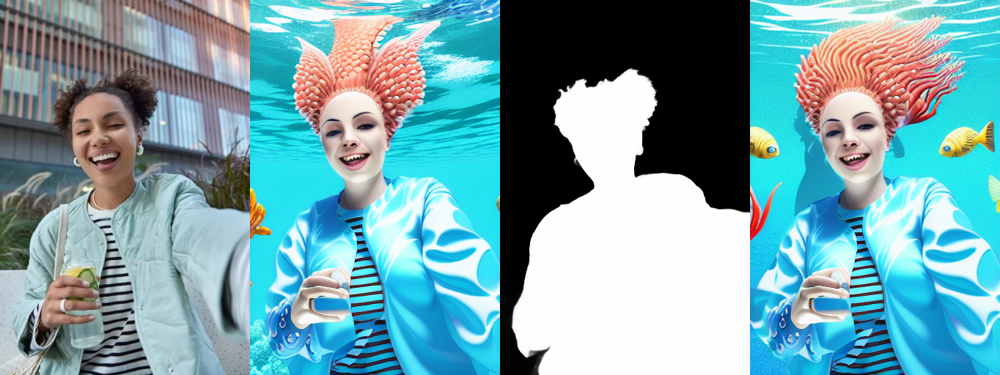

In [270]:
init_image = sd15_image_transform(load_image("./dataset/a.jpg"))
prompt = "mermaid underwater, blue clothes, corals and fishes background, realistic, high quality photo"
background_prompt = prompt

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(init_image, prompt, background_prompt, return_intermediates=True))

Step 1 prompt: a goth woman in a black outfit
Step 2 prompt: at a kids birthday party


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

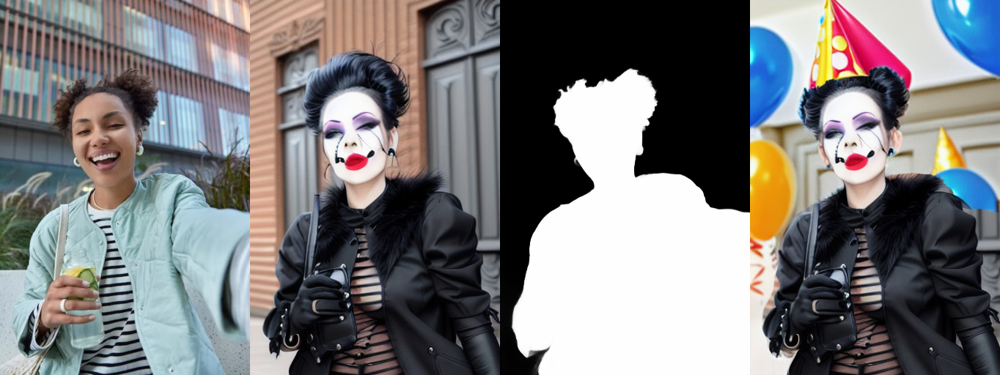

In [271]:
init_image = sd15_image_transform(load_image("./dataset/a.jpg"))
prompt = "a goth woman in a black outfit"
background_prompt = "at a kids birthday party"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    return_intermediates=True)
)

Step 1 prompt: mermaid underwater, blue clothes, corals and fishes background
Step 2 prompt: mermaid underwater, blue clothes, corals and fishes background


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

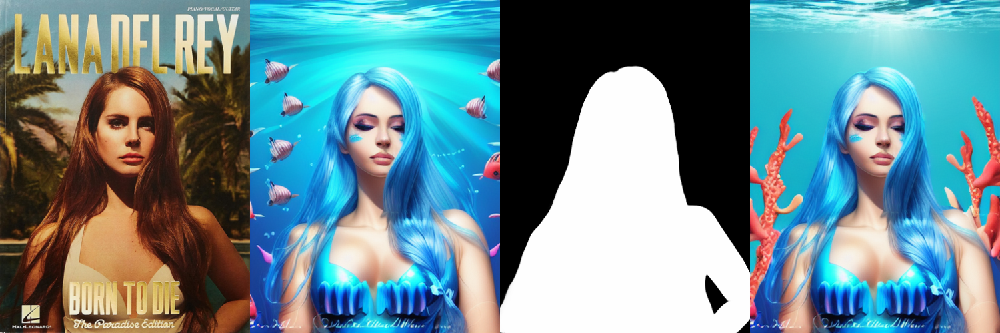

In [272]:
init_image = sd15_image_transform(load_image("./dataset/b.jpg"))
prompt = "mermaid underwater, blue clothes, corals and fishes background"
background_prompt = prompt

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    return_intermediates=True)
)

Step 1 prompt: an African woman
Step 2 prompt: acid pink background


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

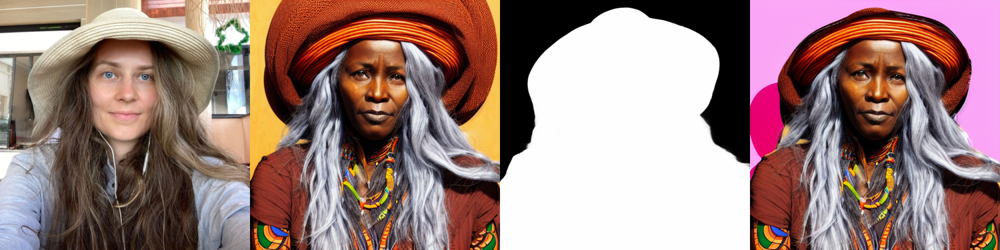

In [283]:
init_image = sd15_image_transform(load_image("./dataset/c.jpg"))
prompt = "an African woman"
background_prompt = "acid pink background"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    return_intermediates=True)
)

Step 1 prompt: a colorful parrot walking into the camera
Step 2 prompt: a colorful parrot walking into the camera on a desk in a busy office


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

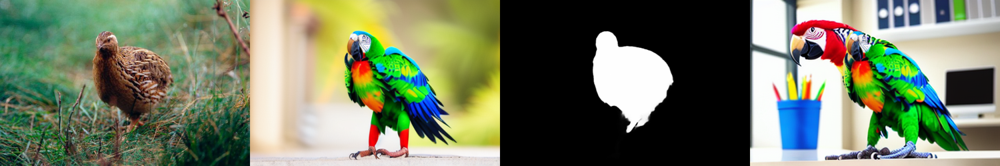

In [274]:
init_image = sd15_image_transform(load_image("./dataset/e.jpg"))
prompt = "a colorful parrot walking into the camera"
background_prompt = prompt + " on a desk in a busy office"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_fg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    return_intermediates=True)
)

**Here I suppose that the object in the image is too small. It seems like the network tends to generate objects full screen (I already noticed that before). Let's try to make controlnet conditioning harder for the second generation step:**

Step 1 prompt: a colorful parrot walking into the camera
Step 2 prompt: a colorful parrot walking into the camera on a desk in a busy office


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

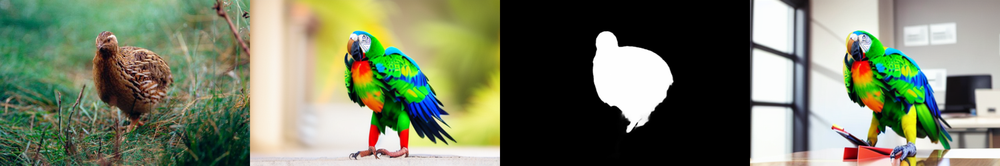

In [275]:
init_image = sd15_image_transform(load_image("./dataset/e.jpg"))
prompt = "a colorful parrot walking into the camera"
background_prompt = prompt + " on a desk in a busy office"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_fg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    extra_bg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    return_intermediates=True)
)

Step 1 prompt: high quality photo of a Superman on skateboard
Step 2 prompt: a skateboarder in a show, dark round arena, dimmed lights


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

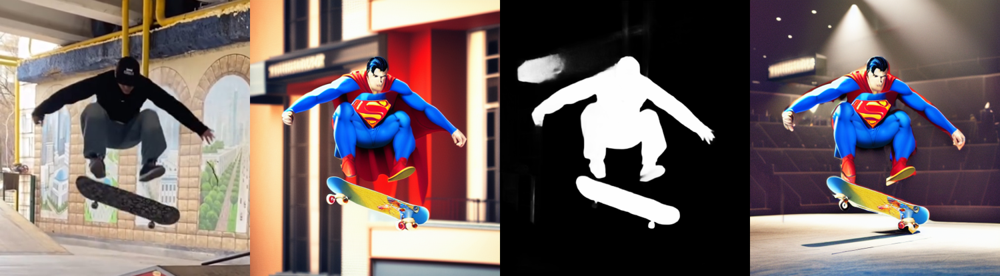

In [284]:
init_image = sd15_image_transform(load_image("./dataset/f.jpg"))
prompt = "high quality photo of a Superman on skateboard"
background_prompt = "a skateboarder in a show, dark round arena, dimmed lights"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    return_intermediates=True)
)

Good to see the cape generated but it was outside the mask so it got erased at the 2nd stage. Even if we run the segmentation model on the generated image, it still doesn't pick up the cape :(

There is also a red border visible around the Superman. This is the case when padding_mask_crop can be turned off for better blending at the cost of slightly altered appearance of the Superman.

Step 1 prompt: high quality photo of a Superman on skateboard
Step 2 prompt: a skateboarder in a show, dark round arena, dimmed lights


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

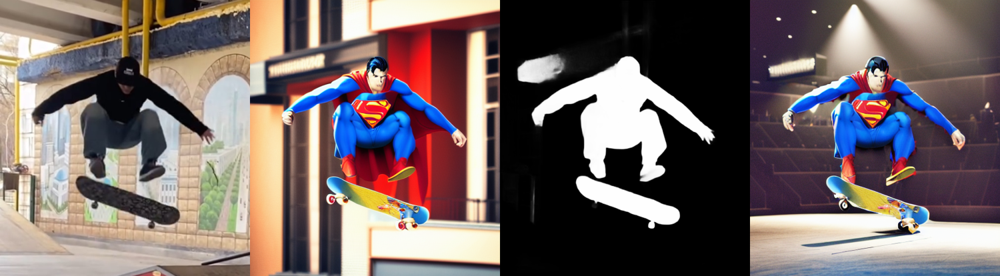

In [277]:
init_image = sd15_image_transform(load_image("./dataset/f.jpg"))
prompt = "high quality photo of a Superman on skateboard"
background_prompt = "a skateboarder in a show, dark round arena, dimmed lights"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_bg_diffusion_kwargs={'padding_mask_crop': None},
    return_intermediates=True)
)

Step 1 prompt: Joker, black and white photo
Step 2 prompt: 1930s skyscraper workers photographing each other at a height, streets visible in the background


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

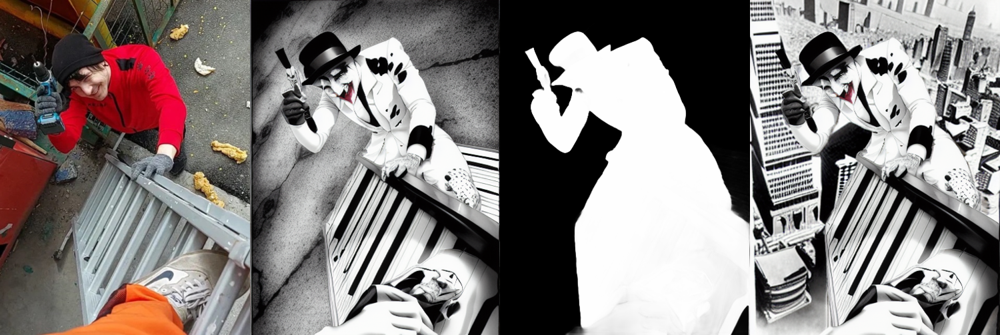

In [278]:
init_image = sd15_image_transform(load_image("./dataset/g.jpg"))
prompt = "Joker, black and white photo"
background_prompt = "1930s skyscraper workers photographing each other at a height, streets visible in the background"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_fg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    detect_background_in_generated_image=True,
    return_intermediates=True)
)

Step 1 prompt: a rainbow colored hatchback car, photographed from back
Step 2 prompt: a car in a very long traffic jam


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

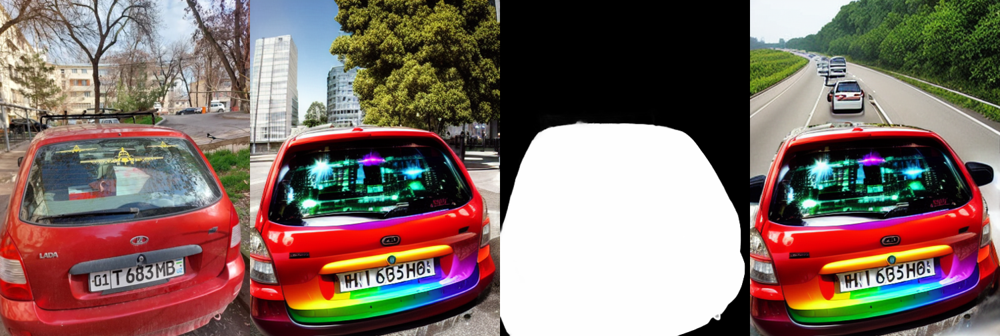

In [279]:
init_image = sd15_image_transform(load_image("./dataset/h.jpg"))
prompt = "a rainbow colored hatchback car, photographed from back"
background_prompt = "a car in a very long traffic jam"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_fg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    return_intermediates=True)
)

Step 1 prompt: a painting in the style of Van Gogh
Step 2 prompt: starry night in the background


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

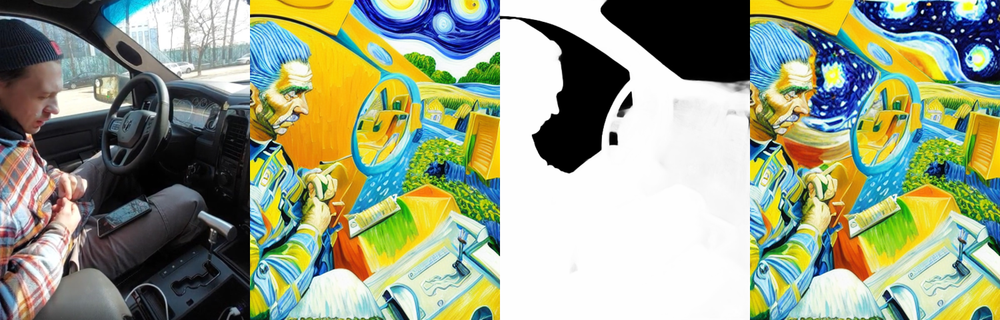

In [280]:
init_image = sd15_image_transform(load_image("./dataset/j.jpg"))
prompt = "a painting in the style of Van Gogh"
background_prompt = "starry night in the background"

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_fg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    return_intermediates=True)
)

Step 1 prompt: John Denver playing guitar in the mountains, high quality film photo
Step 2 prompt: John Denver playing guitar in the mountains, high quality film photo


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

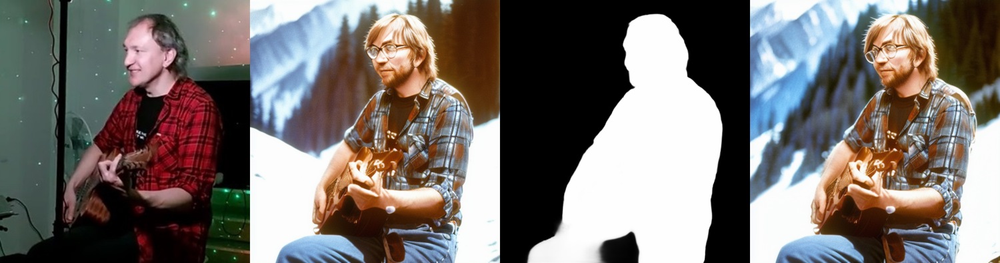

In [281]:
init_image = sd15_image_transform(load_image("./dataset/k.jpg"))
prompt = "John Denver playing guitar in the mountains, high quality film photo"
background_prompt = prompt

print(f"Step 1 prompt: {prompt}\nStep 2 prompt: {background_prompt}")
display_row((init_image,) + stylize(
    init_image,
    prompt,
    background_prompt,
    extra_fg_diffusion_kwargs={'controlnet_conditioning_scale': 1.0},
    return_intermediates=True)
)

## Discussion

*I implemented a reasonable minimum based on my experience and didn't go beyond the tried-and-tested open-source solutions. I did this because (1) we are in the context of a small task, and (2) the task was a little broad and could imply many different use cases and requirements, and called for a general solution. Ideally though, I would study related work, check the latest open source solutions, align with the product requirements. More discussion below.*

-------
I thought of the full method right after reading the task, but while implementing it became apparent that

* in some cases, easier baseline methods could already do the trick;
* there are many small design choices/tradeoffs, and manual tuning is still needed.

**Method 1** (specify background in the prompt) can work well if a smaller control weight is picked (e.g. see `a.jpg` with `controlnet_conditioning_scale=0.75`).

**Method 2** (specify background in the prompt + erase the background in control image) can almost compete with the full method, giving same (`k.jpg`) or even better (`b.jpg`) results. However, it doesn't work when object and background prompts are too different (for example, "a goth woman in a black outfit at a kids birthday party" won't work with SD1.5).

Besides, the erased background can in theory make the rendered background dull (though examples such as `b.jpg` and `h.jpg` contradict this). This could be solved by taking a different ControlNet that is robust to missing parts of control images (either randomly erased during training or simply those input types - such as "normals" - that naturally lack information in the background).

**Method 3** is the most universal one. The biggest problem within this task was that it can create extra content (e.g. new limbs) while rendering the background.

Some design tradeoffs or things that sometimes need to be manually tuned are:

* Should we estimate the foreground mask from the generated image and not the original one (see `{a,b,c,e,f}.jpg`)? Human-in-the-loop / interactive segmentation? (like in Meta/Instagram's AI backdrop)
* How exactly we should run diffusion inpainting (diffusers' algorithm is just one possible option)?
* Should we enable control conditioning while generating the background, to better preserve our object and get rid of "extra limbs" (`b.jpg` and `e.jpg`)? What the control scale should be?
* Choices common with any diffusion problems: better base model, better checkpoint, prompt engineering (probably not so much with newest models), classifier-free guidance scale, denoising algorithm type and parameters etc.

Since this is a small fun project without real users, **if I had more time and resources**, I would just work on the above 4 things. I would start with the last bullet, namely pick a better base model such as FLUX.1 and automate prompt engineering. Then, I would maybe pick an inpainting ControlNet or try some other inpainting methods to avoid "extra limbs".

--------
However, **if I also had an end product, as well as a team and even more time and resources:**

Hypothetical **Method 4.1** would be an off-the-shelf editing pipeline such as [LEDIT++](https://leditsplusplus-project.static.hf.space/index.html).

And hypothetical **Method 4.2** would improve upon it; it would be something new, basing upon and improving over the recent literature ([e.g. here is a nice review on image editing, not too fresh though, early 2024](https://arxiv.org/abs/2402.17525)). This would depend on the product requirements. Is it always a person, or arbitrary object? If it's a person, do we have to preserve identity (see e.g. [InfiniteYou](https://huggingface.co/ByteDance/InfiniteYou))? Does the use case allow interactive segmentation (see e.g. CFR-ICL)? Is it iterative (see e.g. InstructPix2Pix's derivatives)? Do we want temporal/3D consistency for the object/background? etc.